# **Import Libraries**

In [ ]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

import warnings
warnings.filterwarnings("ignore")

# **Lire les données**

In [ ]:
DirPath = "./data/"

In [ ]:
data = pd.read_csv(DirPath + "data.csv")
genre_data = pd.read_csv(DirPath + "data_by_genres.csv")
year_data = pd.read_csv(DirPath + "data_by_year.csv")

In [28]:
print(data)

        valence  year  acousticness  \
0        0.0594  1921       0.98200   
1        0.9630  1921       0.73200   
2        0.0394  1921       0.96100   
3        0.1650  1921       0.96700   
4        0.2530  1921       0.95700   
...         ...   ...           ...   
170648   0.6080  2020       0.08460   
170649   0.7340  2020       0.20600   
170650   0.6370  2020       0.10100   
170651   0.1950  2020       0.00998   
170652   0.6420  2020       0.13200   

                                                  artists  danceability  \
0       ['Sergei Rachmaninoff', 'James Levine', 'Berli...         0.279   
1                                          ['Dennis Day']         0.819   
2       ['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...         0.328   
3                                        ['Frank Parker']         0.275   
4                                          ['Phil Regan']         0.418   
...                                                   ...           ...   
170648

In [ ]:
print(genre_data)

      mode                  genres  acousticness  danceability   duration_ms  \
0        1  21st century classical      0.979333      0.162883  1.602977e+05   
1        1                   432hz      0.494780      0.299333  1.048887e+06   
2        1                   8-bit      0.762000      0.712000  1.151770e+05   
3        1                      []      0.651417      0.529093  2.328809e+05   
4        1              a cappella      0.676557      0.538961  1.906285e+05   
...    ...                     ...           ...           ...           ...   
2968     1                    zolo      0.222625      0.547082  2.580991e+05   
2969     0                 zouglou      0.161000      0.863000  2.063200e+05   
2970     1                    zouk      0.263261      0.748889  3.060728e+05   
2971     0            zurich indie      0.993000      0.705667  1.984173e+05   
2972     1                  zydeco      0.421038      0.629409  1.716717e+05   

        energy  instrumentalness  liven

In [ ]:
print(year_data)

    mode  year  acousticness  danceability    duration_ms    energy  \
0      1  1921      0.886896      0.418597  260537.166667  0.231815   
1      1  1922      0.938592      0.482042  165469.746479  0.237815   
2      1  1923      0.957247      0.577341  177942.362162  0.262406   
3      1  1924      0.940200      0.549894  191046.707627  0.344347   
4      1  1925      0.962607      0.573863  184986.924460  0.278594   
..   ...   ...           ...           ...            ...       ...   
95     1  2016      0.284171      0.600202  221396.510295  0.592855   
96     1  2017      0.286099      0.612217  211115.696787  0.590421   
97     1  2018      0.267633      0.663500  206001.007133  0.602435   
98     1  2019      0.278299      0.644814  201024.788096  0.593224   
99     1  2020      0.219931      0.692904  193728.397537  0.631232   

    instrumentalness  liveness   loudness  speechiness       tempo   valence  \
0           0.344878  0.205710 -17.048667     0.073662  101.531493 

# **La musique au fil du temps**


En utilisant les données regroupées par année, nous pouvons comprendre comment la musique a changé de 1921 à 2020.

<AxesSubplot:xlabel='decenie', ylabel='count'>

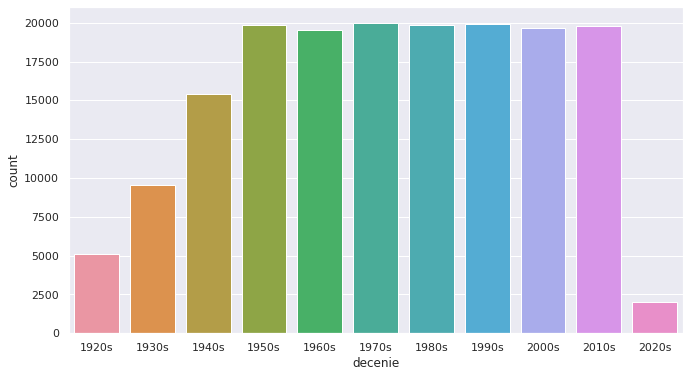

In [ ]:
def get_date(year):
    start = int(year/10) * 10
    decenie = "{}s".format(start)
    return decenie

data["decenie"] = data["year"].apply(get_date)

sns.set(rc={"figure.figsize":(11 ,6)})
sns.countplot(data["decenie"])

In [ ]:
sound_features = ["acousticness", "danceability", "energy", "instrumentalness", "liveness", "valence"]

In [ ]:

figure = px.line(year_data, x="year", y=sound_features)
figure.show()

# **Musique en fonction des genres**

In [ ]:
top_10_genres = genre_data.nlargest(10, "popularity")

figure = px.bar(top_10_genres, x="genres", y=["valence", "energy", "danceability", "acousticness"], barmode="group")
figure.show()

# **Clustering Musique avec K-Means**

In [ ]:
musique_cluster = Pipeline([("scaler", StandardScaler()), 
                                  ("kmeans", KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
cl = list(X.columns)
musique_cluster.fit(X)
musique_cluster_labels = musique_cluster.predict(X)
data["cluster_label"] = musique_cluster_labels

# **Visualisaton du Clusters avec PCA**

In [ ]:
from sklearn.decomposition import PCA

pca_pipeline = Pipeline([("scaler", StandardScaler()), ("PCA", PCA(n_components=2))])
s = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=["x", "y"], data=s)
projection["title"] = data["name"]
projection["cluster"] = data["cluster_label"]

figure = px.scatter(
    projection, x="x", y="y", color="cluster", hover_data=["x", "y", "title"])
figure.show()

# **Système de recommandation**

Sur la base de l`analyse et de la visualisation, il est clair que des genres similaires ont tendance à avoir des points de données proches les uns des autres, et des types de chansons similaires sont également regroupés.
On utilise cette idée pour créer un système de recommandation

In [ ]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

client_id = "f69934d4ada64841b6aac8f7b69bda70"
client_secret = "584ef5b1eebc4ef1b93896f2f272e0f0"

client_manager = SpotifyClientCredentials(client_id=client_id, 
                                                      client_secret=client_secret)                                                     
sp = spotipy.Spotify(client_credentials_manager = client_manager)

In [ ]:
def search(name, year):
    s_data = defaultdict()
    res = sp.search(q= "track: {} year: {}".format(name,year), limit=1)
    if res["tracks"]["items"] == []:
        return None

    res = res["tracks"]["items"][0]
    musique_id = res["id"]
    audio_features = sp.audio_features(musique_id)[0]

    s_data["name"] = [name]
    s_data["year"] = [year]
    s_data["explicit"] = [int(res["explicit"])]
    s_data["duration_ms"] = [res["duration_ms"]]
    s_data["popularity"] = [res["popularity"]]

    for key, value in audio_features.items():
        s_data[key] = value
    return pd.DataFrame(s_data)

In [ ]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib

cl = ["valence", "year", "acousticness", "danceability", "duration_ms", "energy", "explicit",
 "instrumentalness", "key", "liveness", "loudness", "mode", "popularity", "speechiness", "tempo"]

def get_musique(musique, spotify_data):
    try:
        s_data = spotify_data[(spotify_data["name"] == musique["name"]) 
                                & (spotify_data["year"] == musique["year"])].iloc[0]
        return s_data
    except IndexError:
        return search(musique["name"], musique["year"])
        
def moyenne_vecteur(musique_list, spotify_data):
    musique_vectors = []
    for musique in musique_list:
        s_data = get_musique(musique, spotify_data)
        if s_data is None:
            print("n'existe pas")
            continue
        musique_vector = s_data[cl].values
        musique_vectors.append(musique_vector)  
    musique_matrix = np.array(list(musique_vectors))
    return np.mean(musique_matrix, axis=0)

def lists(dict_list):   
    dict = defaultdict()
    for key in dict_list[0].keys():
        dict[key] = []
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            dict[key].append(value)
            
    return dict

In [ ]:
def recommandation( musique_list, spotify_data, n_musiques=15): 
    donne = ["name", "year", "artists"]
    musique_dict = lists(musique_list)
    
    musique_center = moyenne_vecteur(musique_list, spotify_data)
    scaler = musique_cluster.steps[0][1]
    scaled = scaler.transform(spotify_data[cl])
    scaled_musique= scaler.transform(musique_center.reshape(1, -1))
    distances = cdist(scaled_musique, scaled, "cosine")
    index = list(np.argsort(distances)[:, :n_musiques][0])
    
    rec_musiques = spotify_data.iloc[index]
    rec_musiques = rec_musiques[~rec_musiques["name"].isin(musique_dict["name"])]
    return rec_musiques[donne].to_dict(orient="records")

In [ ]:
recommandation([{"name": "Α. Nwaar Is The New Black", "year":2017},
                {"name": "B. #QuedusaalVie", "year": 2017},
                {"name": "Baltringue", "year": 2018},
                {"name": "Δ. Dieu ne ment jamais", "year": 2017},
                {"name": "Ε. Signaler", "year": 2017}],  data)

[{'name': '20 Years Later', 'year': 2018, 'artists': "['Yung Pinch']"},
 {'name': 'Virtual (Blue Balenciagas)',
  'year': 2018,
  'artists': "['YNW Melly']"},
 {'name': 'VALENTINO', 'year': 2019, 'artists': "['24kGoldn']"},
 {'name': 'My Beyoncé', 'year': 2016, 'artists': "['Lil Durk', 'DeJ Loaf']"},
 {'name': "Grass Ain't Greener", 'year': 2017, 'artists': "['Chris Brown']"},
 {'name': 'Dark Conversations', 'year': 2019, 'artists': "['Rod Wave']"},
 {'name': 'Come Closer (feat. Queen Naija)',
  'year': 2018,
  'artists': "['A Boogie Wit da Hoodie', 'Queen Naija']"},
 {'name': "Don't Wanna Breathe", 'year': 2017, 'artists': "['Kodak Black']"},
 {'name': 'Halloween', 'year': 2017, 'artists': "['Kodak Black']"},
 {'name': 'Gnarly (feat. Lil Pump)',
  'year': 2018,
  'artists': "['Kodak Black', 'Lil Pump']"},
 {'name': 'R.I.P.', 'year': 2018, 'artists': "['Playboi Carti']"},
 {'name': '911', 'year': 2018, 'artists': "['Ellise']"},
 {'name': 'Faking It (feat. Kehlani & Lil Yachty)',
  'yea